In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
from tqdm import tqdm
%matplotlib inline
from torch.utils.data import Dataset, DataLoader
import torch
import torchvision
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.datasets import make_moons

import torch.nn as nn
import torch.nn.functional as F

from plots import plot_analysis,focus_map,classification_map
from Models_Elemental import Focus_linear,Classification_linear
from Models_Elemental import Focus_deep,Classification_deep
from train_mosaic_new import train_mosaic_network
from train_model import train_network


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu
cpu


In [2]:
n_classes = 5
n_data = n_classes*100
n_mosaic = 3000
K = 5
d = 2

In [3]:
y = np.random.randint(0,n_classes,n_data)
idx= []
for i in range(n_classes):
    print(i,sum(y==i))
    idx.append(y==i)

0 112
1 79
2 83
3 108
4 118


In [4]:
x = np.zeros((n_data,d))

In [5]:
x[idx[0],:] = np.random.multivariate_normal(mean = [0,0],cov=[[5,0],[0,5]],size=sum(idx[0]))

# x[idx[0],:] = np.random.multivariate_normal(mean = [0,25],cov=[[5,0],[0,5]],size=sum(idx[0]))

x[idx[1],:] = np.random.multivariate_normal(mean = [6,0],cov=[[5,0],[0,5]],size=sum(idx[1]))

x[idx[2],:] = np.random.multivariate_normal(mean = [12,0],cov=[[5,0],[0,5]],size=sum(idx[2]))

x[idx[3],:] = np.random.multivariate_normal(mean = [6,6],cov=[[5,0],[0,5]],size=sum(idx[3]))

x[idx[4],:] = np.random.multivariate_normal(mean = [0,-8],cov=[[5,0],[0,5]],size=sum(idx[4]))


# x[idx[5],:] = np.random.multivariate_normal(mean = [-8,-15],cov=[[10,7],[7,20]],size=sum(idx[5]))

# # x[idx[7],:] = np.random.multivariate_normal(mean = [25,-30],cov=[[8,0],[0,8]],size=sum(idx[7]))

# # x[idx[8],:] = np.random.multivariate_normal(mean = [-12,-15],cov=[[8,0],[0,8]],size=sum(idx[8]))

# # x[idx[9],:] = np.random.multivariate_normal(mean = [-2,20],cov=[[8,0],[0,8]],size=sum(idx[9]))

In [6]:
# x, y = make_moons(n_samples=200, noise=0.05, random_state=0)
# x1, y1 = make_moons(n_samples=200, noise=0.05, random_state=1)


In [7]:
# x1[y1==0,0] = x1[y1==0,0] + 2.5
# x1[y1==1,0] = x1[y1==1,0] - 2.5
# y1[y1==0] =2
# y1[y1==1] =3



In [8]:
# x = np.concatenate((x,x1),axis=0)
# y =np.concatenate((y,y1),axis=0)
# print(x.shape,y.shape)

In [9]:
# x1 = np.ones((50,2))
# x1[:,0] = np.linspace(0,0.4)
# x1[:,1] = x1[:,1]*1
# y1 = np.ones(50)

# x2 = np.ones((50,2))
# x2[:,0] = np.linspace(0.5,0.9)
# x2[:,1] = x2[:,1]*1
# y2 = np.zeros(50)

# x3 = np.ones((50,2))
# x3[:,0] = np.linspace(1.,1.4)
# x3[:,1] = x3[:,1]*1
# y3 = np.ones(50)

# x4 = np.ones((50,2))
# x4[:,0] = np.linspace(0.1,0.5)
# x4[:,1] = x4[:,1]*2
# y4 = np.zeros(50)

# x5 = np.ones((50,2))
# x5[:,0] = np.linspace(-0.4,-0)
# x5[:,1] = x5[:,1]*2
# y5 = np.ones(50)

# x6 = np.ones((50,2))
# x6[:,0] = np.linspace(-0.9,-0.5)
# x6[:,1] = x6[:,1]*2
# y6 = np.zeros(50)

# x7 = np.ones((100,2))
# x7[:,0]= np.linspace(-0.4,1.4,100)
# x7[:,1] = x7[:,1]*1.5
# y7 = np.ones(100)*2
# # plt.scatter(x[,0],x[:,1])
# # plt.scatter(x1[:,0],x1[:,1])

# # plt.scatter(x2[:,0],x2[:,1])
# # plt.scatter(x3[:,0],x3[:,1])
# # plt.scatter(x4[:,0],x4[:,1])
# x = np.concatenate((x1,x2,x3,x4,x5,x6,x7),axis=0)
# y= np.concatenate((y1,y2,y3,y4,y5,y6,y7),axis=0)

In [10]:
# idx= []
# for i in range(3):
#     print(i,sum(y==i))
#     idx.append(y==i)

In [11]:
std = StandardScaler()
std.fit(x)
x = std.transform(x)
x.shape

(500, 2)

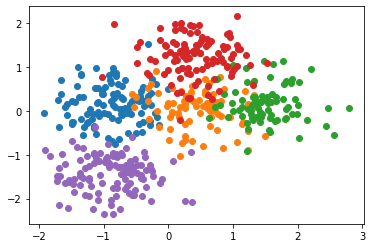

In [12]:
for i in range(n_classes):
    plt.scatter(x[y==i,0],x[y==i,1],label="class_"+str(i))
#plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

In [13]:
foreground_classes = {'class_0' ,'class_1'}

background_classes = {'class_2','class_3'}#,'class_4', 'class_5', 'class_6','class_7', 'class_8', 'class_9'}

In [14]:

mosaic_list =[]
mosaic_label = []
fore_idx=[]
for j in range(n_mosaic):
    fg_class  = np.random.randint(0,len(foreground_classes))
    fg_idx = np.random.randint(0,K)
    a = []
    for i in range(K):
        if i == fg_idx:
            b = np.random.choice(np.where(idx[fg_class]==True)[0],size=1)
            a.append(x[b])
#             print("foreground "+str(fg_class)+" present at " + str(fg_idx))
        else:
            bg_class = np.random.randint(len(foreground_classes),n_classes)
            b = np.random.choice(np.where(idx[bg_class]==True)[0],size=1)
            a.append(x[b])
#             print("background "+str(bg_class)+" present at " + str(i))
    a = np.concatenate(a,axis=0)
    mosaic_list.append(np.reshape(a,(d*K,1)))
    mosaic_label.append(fg_class)
    fore_idx.append(fg_idx)

In [15]:
mosaic_list = np.concatenate(mosaic_list,axis=1).T
mosaic_list.shape

(3000, 10)

In [16]:
sv = SVC(C=1000,kernel="linear")
sv.fit(mosaic_list,mosaic_label)
print(sv.score(mosaic_list,mosaic_label))

0.6303333333333333


In [17]:
class MosaicDataset(Dataset):
  """MosaicDataset dataset."""

  def __init__(self, mosaic_list, mosaic_label, fore_idx):
    """
      Args:
        csv_file (string): Path to the csv file with annotations.
        root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    self.mosaic = mosaic_list
    self.label = mosaic_label
    self.fore_idx = fore_idx

  def __len__(self):
    return len(self.label)

  def __getitem__(self, idx):
    return self.mosaic[idx] , self.label[idx], self.fore_idx[idx]

batch = 250
msd = MosaicDataset(mosaic_list, mosaic_label , fore_idx)
train_loader = DataLoader( msd,batch_size= batch ,shuffle=True)

In [18]:
where = Focus_linear(2,1,K).double()
what = Classification_linear(2,2).double()

In [19]:
train_mosaic = train_mosaic_network(where,what,train_loader,elemental=True,x=x,y=y)

Training started...
[1,     3] loss: 0.815
[1,     6] loss: 0.806
[1,     9] loss: 0.806
[1,    12] loss: 0.765
[2,     3] loss: 0.784
[2,     6] loss: 0.737
[2,     9] loss: 0.742
[2,    12] loss: 0.726
[3,     3] loss: 0.728
[3,     6] loss: 0.720
[3,     9] loss: 0.714
[3,    12] loss: 0.720
[4,     3] loss: 0.712
[4,     6] loss: 0.711
[4,     9] loss: 0.710
[4,    12] loss: 0.703
[5,     3] loss: 0.704
[5,     6] loss: 0.702
[5,     9] loss: 0.697
[5,    12] loss: 0.702
[6,     3] loss: 0.696
[6,     6] loss: 0.700
[6,     9] loss: 0.695
[6,    12] loss: 0.690
[7,     3] loss: 0.696
[7,     6] loss: 0.692
[7,     9] loss: 0.686
[7,    12] loss: 0.691
[8,     3] loss: 0.694
[8,     6] loss: 0.683
[8,     9] loss: 0.687
[8,    12] loss: 0.688
[9,     3] loss: 0.679
[9,     6] loss: 0.687
[9,     9] loss: 0.688
[9,    12] loss: 0.684
[10,     3] loss: 0.683
[10,     6] loss: 0.683
[10,     9] loss: 0.679
[10,    12] loss: 0.678


/content/plots.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(6,6))
/content/plots.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(6,6))


[11,     3] loss: 0.675
[11,     6] loss: 0.678
[11,     9] loss: 0.676
[11,    12] loss: 0.678
[12,     3] loss: 0.667
[12,     6] loss: 0.675
[12,     9] loss: 0.671
[12,    12] loss: 0.673
[13,     3] loss: 0.672
[13,     6] loss: 0.665
[13,     9] loss: 0.666
[13,    12] loss: 0.661
[14,     3] loss: 0.666
[14,     6] loss: 0.665
[14,     9] loss: 0.653
[14,    12] loss: 0.651
[15,     3] loss: 0.657
[15,     6] loss: 0.651
[15,     9] loss: 0.647
[15,    12] loss: 0.646
[16,     3] loss: 0.648
[16,     6] loss: 0.641
[16,     9] loss: 0.639
[16,    12] loss: 0.635
[17,     3] loss: 0.624
[17,     6] loss: 0.640
[17,     9] loss: 0.635
[17,    12] loss: 0.621
[18,     3] loss: 0.617
[18,     6] loss: 0.626
[18,     9] loss: 0.620
[18,    12] loss: 0.616
[19,     3] loss: 0.619
[19,     6] loss: 0.609
[19,     9] loss: 0.613
[19,    12] loss: 0.598
[20,     3] loss: 0.593
[20,     6] loss: 0.604
[20,     9] loss: 0.603
[20,    12] loss: 0.603
[21,     3] loss: 0.603
[21,     6] loss

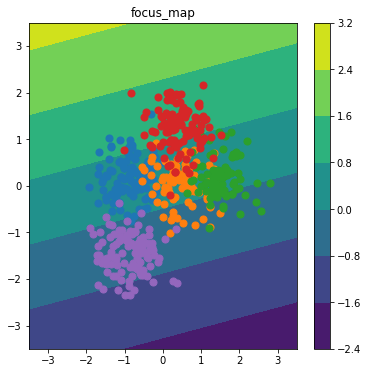

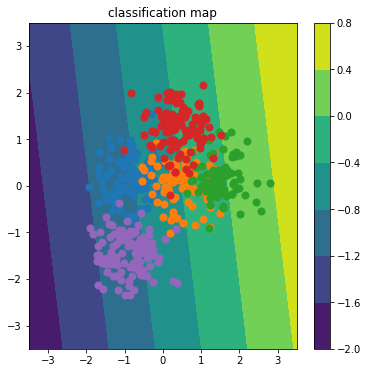

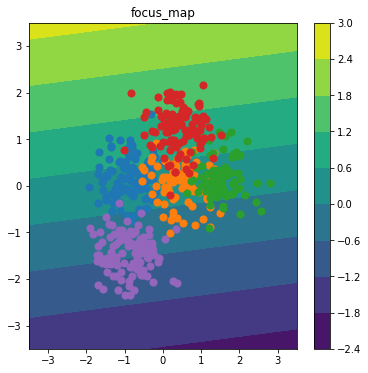

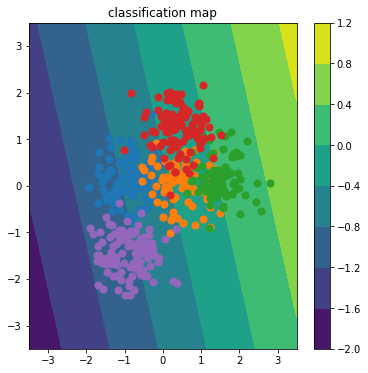

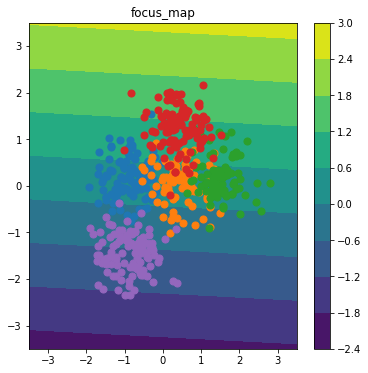

...

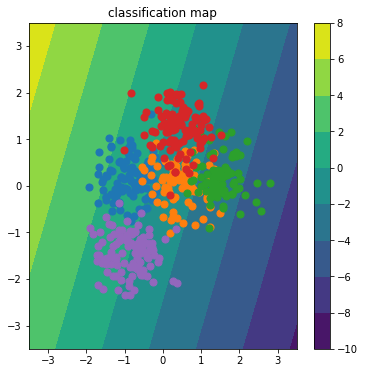

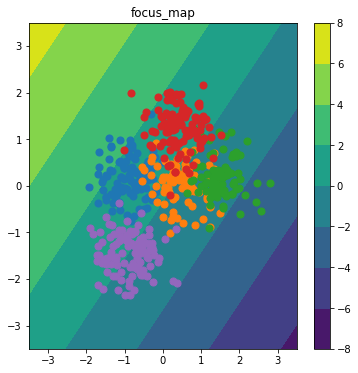

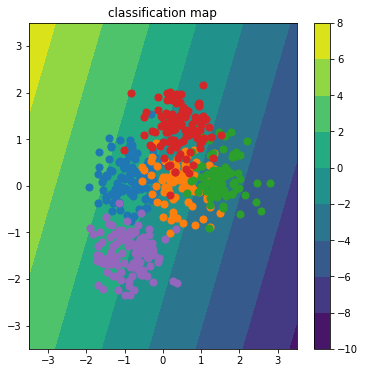

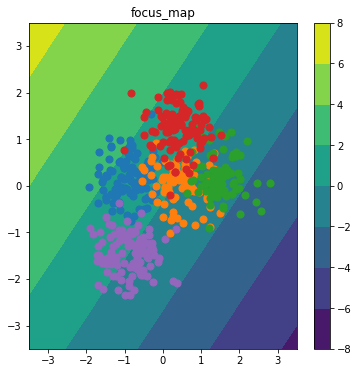

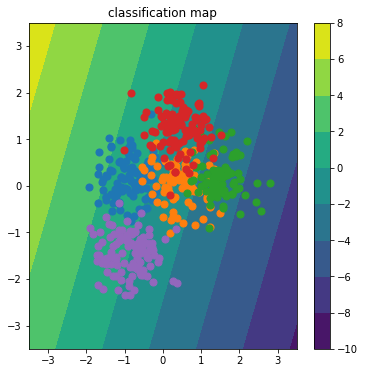

In [20]:
train_mosaic.training(epochs=200,mini=3)

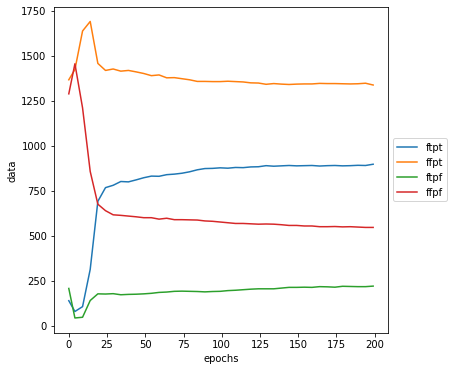

In [21]:
plot_analysis(np.array(train_mosaic.train_analysis))

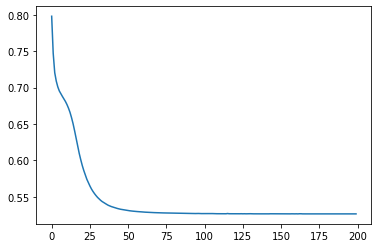

In [22]:
plt.plot(train_mosaic.train_loss)

In [23]:
_,_,_,_ = train_mosaic.predict(train_loader,True)

percentage accuracy:  0.7446666666666667


In [24]:
where_deep = Focus_deep(2,1,K).double()
what_deep = Classification_deep(2,2).double()

In [25]:
train_mosaic_deep = train_mosaic_network(where_deep,what_deep,train_loader,elemental=True,x=x,y=y)

Training started...
[1,     3] loss: 0.691
[1,     6] loss: 0.689
[1,     9] loss: 0.690
[1,    12] loss: 0.684
[2,     3] loss: 0.680
[2,     6] loss: 0.680
[2,     9] loss: 0.672
[2,    12] loss: 0.673
[3,     3] loss: 0.665
[3,     6] loss: 0.671
[3,     9] loss: 0.658
[3,    12] loss: 0.656
[4,     3] loss: 0.657
[4,     6] loss: 0.655
[4,     9] loss: 0.644
[4,    12] loss: 0.644
[5,     3] loss: 0.640
[5,     6] loss: 0.641
[5,     9] loss: 0.631
[5,    12] loss: 0.628
[6,     3] loss: 0.621
[6,     6] loss: 0.632
[6,     9] loss: 0.604
[6,    12] loss: 0.607
[7,     3] loss: 0.606
[7,     6] loss: 0.601
[7,     9] loss: 0.581
[7,    12] loss: 0.584
[8,     3] loss: 0.568
[8,     6] loss: 0.582
[8,     9] loss: 0.562
[8,    12] loss: 0.548
[9,     3] loss: 0.545
[9,     6] loss: 0.538
[9,     9] loss: 0.533
[9,    12] loss: 0.516
[10,     3] loss: 0.520
[10,     6] loss: 0.499
[10,     9] loss: 0.474
[10,    12] loss: 0.509


/content/plots.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(6,6))
/content/plots.py:50: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=(6,6))


[11,     3] loss: 0.483
[11,     6] loss: 0.480
[11,     9] loss: 0.453
[11,    12] loss: 0.457
[12,     3] loss: 0.437
[12,     6] loss: 0.437
[12,     9] loss: 0.419
[12,    12] loss: 0.458
[13,     3] loss: 0.427
[13,     6] loss: 0.414
[13,     9] loss: 0.405
[13,    12] loss: 0.388
[14,     3] loss: 0.381
[14,     6] loss: 0.383
[14,     9] loss: 0.398
[14,    12] loss: 0.366
[15,     3] loss: 0.355
[15,     6] loss: 0.355
[15,     9] loss: 0.371
[15,    12] loss: 0.348
[16,     3] loss: 0.344
[16,     6] loss: 0.344
[16,     9] loss: 0.354
[16,    12] loss: 0.300
[17,     3] loss: 0.315
[17,     6] loss: 0.333
[17,     9] loss: 0.308
[17,    12] loss: 0.314
[18,     3] loss: 0.320
[18,     6] loss: 0.286
[18,     9] loss: 0.308
[18,    12] loss: 0.297
[19,     3] loss: 0.284
[19,     6] loss: 0.283
[19,     9] loss: 0.298
[19,    12] loss: 0.295
[20,     3] loss: 0.292
[20,     6] loss: 0.277
[20,     9] loss: 0.293
[20,    12] loss: 0.257
[21,     3] loss: 0.274
[21,     6] loss

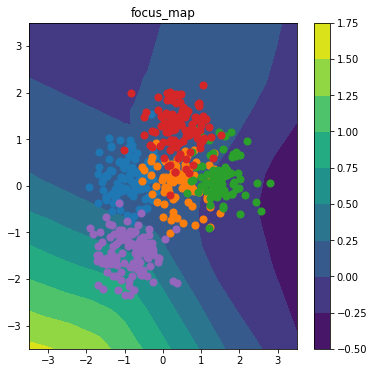

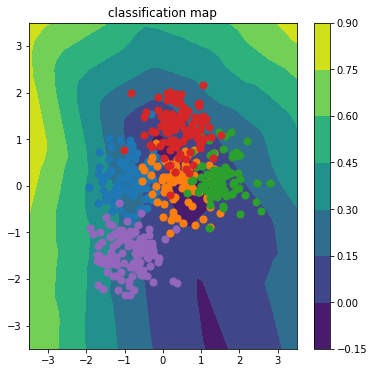

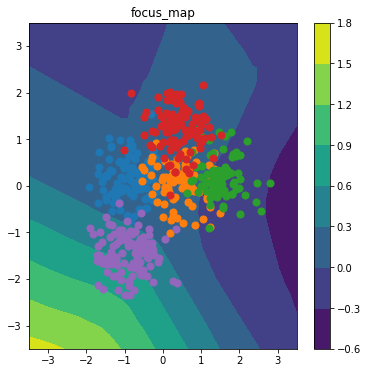

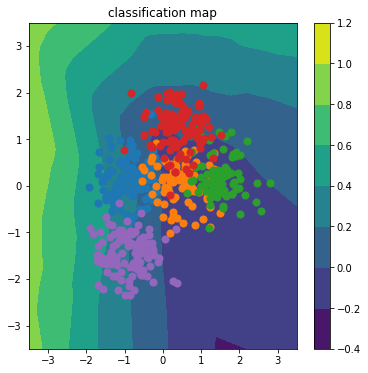

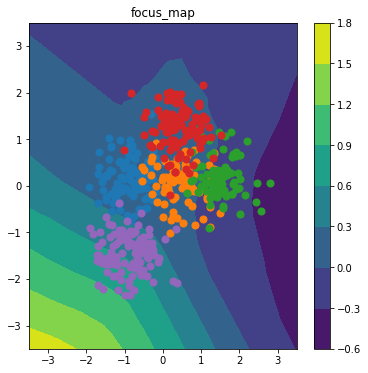

...

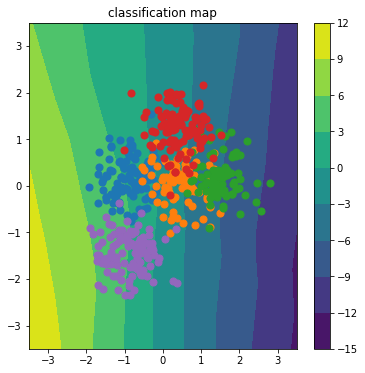

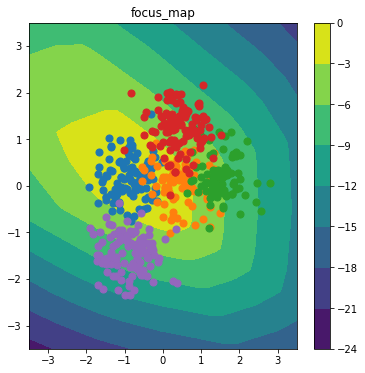

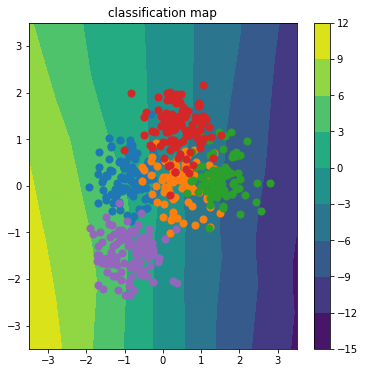

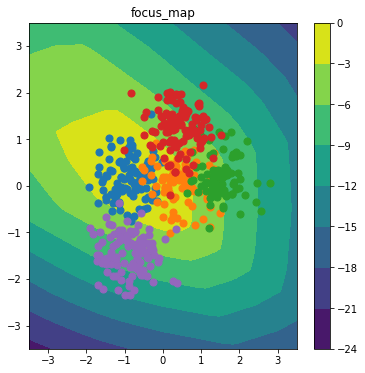

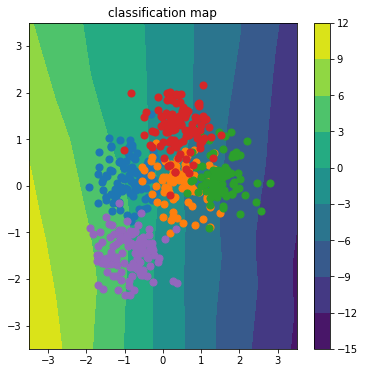

In [26]:
train_mosaic_deep.training(epochs=200,mini=3)

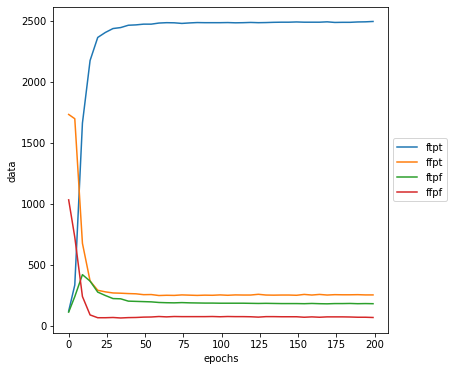

In [27]:
plot_analysis(np.array(train_mosaic_deep.train_analysis))

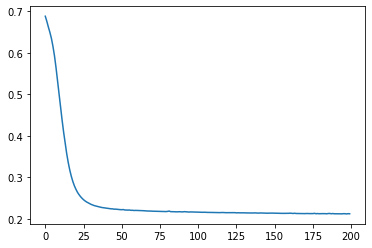

In [28]:
plt.plot(train_mosaic_deep.train_loss)

In [29]:
_,_,_,_ = train_mosaic_deep.predict(train_loader,True)

percentage accuracy:  0.9163333333333333


In [30]:
class Net(nn.Module):
  def __init__(self):
    super(Net,self).__init__()
    self.linear1 = nn.Linear(10,50)
    self.linear2 = nn.Linear(50,50)
    self.linear3 = nn.Linear(50,50)
    self.linear4 = nn.Linear(50,2)
  def forward(self,x):
    x = F.relu(self.linear1(x))
    x = F.relu(self.linear2(x))
    x = F.relu(self.linear3(x))
    x = F.relu(self.linear4(x))
    return x

In [31]:
class MosaicDataset(Dataset):
  """MosaicDataset dataset."""

  def __init__(self, mosaic_list, mosaic_label):
    """
      Args:
        csv_file (string): Path to the csv file with annotations.
        root_dir (string): Directory with all the images.
        transform (callable, optional): Optional transform to be applied
            on a sample.
    """
    self.mosaic = mosaic_list
    self.label = mosaic_label
    

  def __len__(self):
    return len(self.label)

  def __getitem__(self, idx):
    return self.mosaic[idx] , self.label[idx]

batch = 250
dataset = MosaicDataset(mosaic_list, mosaic_label )
traindataloader = DataLoader( dataset,batch_size= batch ,shuffle=True)

In [32]:
net = Net().double()
net =net.to(device)
train_model =train_network(net,traindataloader)

In [33]:
train_model.training(epochs=800,mini=3)

Training started...
[1,     3] loss: 0.693
[1,     6] loss: 0.693
[1,     9] loss: 0.693
[1,    12] loss: 0.693
[2,     3] loss: 0.693
[2,     6] loss: 0.692
[2,     9] loss: 0.693
[2,    12] loss: 0.692
[3,     3] loss: 0.692
[3,     6] loss: 0.691
[3,     9] loss: 0.692
[3,    12] loss: 0.691
[4,     3] loss: 0.690
[4,     6] loss: 0.692
[4,     9] loss: 0.691
[4,    12] loss: 0.691
[5,     3] loss: 0.690
[5,     6] loss: 0.691
[5,     9] loss: 0.690
[5,    12] loss: 0.689
[6,     3] loss: 0.691
[6,     6] loss: 0.688
[6,     9] loss: 0.689
[6,    12] loss: 0.688
[7,     3] loss: 0.690
[7,     6] loss: 0.689
[7,     9] loss: 0.688
[7,    12] loss: 0.687
[8,     3] loss: 0.686
[8,     6] loss: 0.688
[8,     9] loss: 0.688
[8,    12] loss: 0.689
[9,     3] loss: 0.689
[9,     6] loss: 0.685
[9,     9] loss: 0.685
[9,    12] loss: 0.687
[10,     3] loss: 0.685
[10,     6] loss: 0.688
[10,     9] loss: 0.683
[10,    12] loss: 0.686
[11,     3] loss: 0.690
[11,     6] loss: 0.684
[11,    

In [34]:
train_model.predict(traindataloader,True)

percentage accuracy:  0.9923333333333333


(array([0, 0, 0, ..., 1, 1, 1]), array([0, 0, 0, ..., 1, 1, 1]))

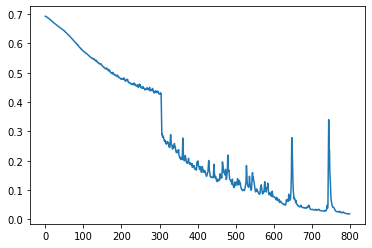

In [35]:
plt.plot(train_model.train_loss)